<div style="float:left">
    <h1 style="width:600px">Objective 2: Regression Models</h1>
</div>
<div style="float:right"><img width="100" src="https://github.com/jreades/i2p/raw/master/img/casa_logo.jpg" /></div>

# 0. Loading Library

In [4]:
import pandas as pd
from sklearn.linear_model import LinearRegression

import numpy as np

import sklearn
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix

import matplotlib.pyplot as plt
import matplotlib
# import seaborn as sn

from time import time

# 1. Travel time result

## 1.1 Merge Datasets

In [7]:
import pandas as pd

Walk = pd.read_csv("Travel_time_Result_final/travel_times_WALK_0822.csv")
Transit = pd.read_csv("Travel_time_Result_final/travel_times_TRANSIT_0822.csv")
Walk_and_Transit = pd.read_csv("Travel_time_Result_final/travel_times_BOTH_0822.csv")
Car = pd.read_csv("Travel_time_Result_final/travel_times_CAR_0822.csv")
Bicycle = pd.read_csv("Travel_time_Result_final/travel_times_BICYCLE_0822.csv")

In [8]:
Walk.head(2)

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,travel_time
0,1,E01000001,City of London 001A,532123,181632,-0.09714,51.51816,c0565620-19c9-46e4-aea5-7031bb89b7d2,"POLYGON ((532151.5375 181867.433499999, 532152...",1,1,183,10.0
1,2,E01000002,City of London 001B,532480,181715,-0.09197,51.51882,6aac6ffa-0cca-4aec-9a0a-1eeace1ea636,"POLYGON ((532634.497 181926.016000001, 532632....",2,2,183,7.0


In [9]:
Walk.shape

(4994, 13)

In [10]:
import pandas as pd

# First, merge Walk and Transit
merged_df = pd.merge(
    Walk[['FID', 'LSOA21CD', 'LSOA21NM', 'BNG_E', 'BNG_N', 'LONG', 'LAT', 'GlobalID', 'geometry', 'id', 'from_id', 'to_id', 'travel_time']],
    Transit[['from_id', 'to_id', 'travel_time']],
    on=['from_id', 'to_id'],
    suffixes=('_Walk', '_Transit')
)

# Then sequentially merge Walk_and_Transit, Car, Bicycle
merged_df = pd.merge(
    merged_df,
    Walk_and_Transit[['from_id', 'to_id', 'travel_time']],
    on=['from_id', 'to_id'],
    how='left'
).rename(columns={'travel_time': 'Walk_and_Transit_travel_time'})

merged_df = pd.merge(
    merged_df,
    Car[['from_id', 'to_id', 'travel_time']],
    on=['from_id', 'to_id'],
    how='left'
).rename(columns={'travel_time': 'Car_travel_time'})

merged_df = pd.merge(
    merged_df,
    Bicycle[['from_id', 'to_id', 'travel_time']],
    on=['from_id', 'to_id'],
    how='left'
).rename(columns={'travel_time': 'Bicycle_travel_time'})

# Rename the columns from the final merge
merged_df = merged_df.rename(columns={'travel_time_Walk': 'Walk_travel_time', 'travel_time_Transit': 'Transit_travel_time'})

In [11]:
merged_df.head(2)

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time
0,1,E01000001,City of London 001A,532123,181632,-0.09714,51.51816,c0565620-19c9-46e4-aea5-7031bb89b7d2,"POLYGON ((532151.5375 181867.433499999, 532152...",1,1,183,10.0,10.0,10.0,4,8
1,2,E01000002,City of London 001B,532480,181715,-0.09197,51.51882,6aac6ffa-0cca-4aec-9a0a-1eeace1ea636,"POLYGON ((532634.497 181926.016000001, 532632....",2,2,183,7.0,7.0,7.0,2,5


## 1.2 Check the difference between "WALK.MODE" and "TRANSIT.MODE"

In [13]:
import pandas as pd

# Assuming merged_df DataFrame already contains all merged data

# Create boolean columns indicating whether the two columns are the same
merged_df['Walk_vs_Transit'] = merged_df['Walk_travel_time'] == merged_df['Transit_travel_time']
merged_df['Walk_vs_Walk_and_Transit'] = merged_df['Walk_travel_time'] == merged_df['Walk_and_Transit_travel_time']
merged_df['Transit_vs_Walk_and_Transit'] = merged_df['Transit_travel_time'] == merged_df['Walk_and_Transit_travel_time']

# Extract rows where the two columns are different, generating new DataFrames
diff_walk_transit = merged_df[~merged_df['Walk_vs_Transit']].copy()
diff_walk_walk_and_transit = merged_df[~merged_df['Walk_vs_Walk_and_Transit']].copy()
diff_transit_walk_and_transit = merged_df[~merged_df['Transit_vs_Walk_and_Transit']].copy()

# Drop the boolean columns since they were only used for comparison
diff_walk_transit.drop(columns=['Walk_vs_Transit', 'Walk_vs_Walk_and_Transit', 'Transit_vs_Walk_and_Transit'], inplace=True)
diff_walk_walk_and_transit.drop(columns=['Walk_vs_Transit', 'Walk_vs_Walk_and_Transit', 'Transit_vs_Walk_and_Transit'], inplace=True)
diff_transit_walk_and_transit.drop(columns=['Walk_vs_Transit', 'Walk_vs_Walk_and_Transit', 'Transit_vs_Walk_and_Transit'], inplace=True)


In [14]:
# Display the number of different rows and the first few rows of the generated DataFrame
print(f"Number of different rows between Walk and Transit modes: {len(diff_walk_transit)}")

diff_walk_transit.head(2)

Number of different rows between Walk and Transit modes: 202


,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time
33,34,E01000038,Barking and Dagenham 003C,550700,187149,0.172761,51.56309,fa864750-afff-44f5-8357-b1a4404f4026,"POLYGON ((550920.362 187341.138, 550921.876 18...",34,34,282,48.0,43.0,43.0,8,19
215,216,E01000228,Barnet 007A,521213,194146,-0.249990,51.63307,728f20bf-3abe-4835-ab44-75e08ac4cf18,"POLYGON ((520025.219 195196.687000001, 520049....",216,216,314,43.0,35.0,35.0,5,18


In [15]:
print(f"Number of different rows between Walk and Walk_and_Transit modes: {len(diff_walk_walk_and_transit)}")

diff_walk_walk_and_transit.head(2)

Number of different rows between Walk and Walk_and_Transit modes: 202


,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time
33,34,E01000038,Barking and Dagenham 003C,550700,187149,0.172761,51.56309,fa864750-afff-44f5-8357-b1a4404f4026,"POLYGON ((550920.362 187341.138, 550921.876 18...",34,34,282,48.0,43.0,43.0,8,19
215,216,E01000228,Barnet 007A,521213,194146,-0.249990,51.63307,728f20bf-3abe-4835-ab44-75e08ac4cf18,"POLYGON ((520025.219 195196.687000001, 520049....",216,216,314,43.0,35.0,35.0,5,18


In [16]:
print(f"Number of different rows between Transit and Walk_and_Transit modes: {len(diff_transit_walk_and_transit)}")

diff_transit_walk_and_transit.head(5)

Number of different rows between Transit and Walk_and_Transit modes: 3


,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time
1363,1364,E01001418,Enfield 011C,528746,196116,-0.140480,51.64910,c9f3d23c-e355-4b59-872e-5b151a751eab,"POLYGON ((528987.426 196489.257999999, 528990....",1364,1364,333,NaN,NaN,NaN,3,9
2636,2637,E01002775,Islington 014D,532336,184986,-0.092810,51.54825,e8d170fa-b982-4d09-b92b-8b2644096c5b,"POLYGON ((532211.796 185057.685000001, 532209....",2637,2637,229,NaN,NaN,NaN,5,10
4847,32517,E01034478,Barking and Dagenham 019I,547576,182291,0.125691,51.52026,1d6afc44-40b3-41ad-8537-ad5139df2a13,"POLYGON ((547525 182987, 547548.97 182981.1300...",32517,32517,169,NaN,NaN,NaN,38,90


In [17]:
merged_df.head(5)

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time,Walk_vs_Transit,Walk_vs_Walk_and_Transit,Transit_vs_Walk_and_Transit
0,1,E01000001,City of London 001A,532123,181632,-0.097140,51.51816,c0565620-19c9-46e4-aea5-7031bb89b7d2,"POLYGON ((532151.5375 181867.433499999, 532152...",1,1,183,10.0,10.0,10.0,4,8,True,True,True
1,2,E01000002,City of London 001B,532480,181715,-0.091970,51.51882,6aac6ffa-0cca-4aec-9a0a-1eeace1ea636,"POLYGON ((532634.497 181926.016000001, 532632....",2,2,183,7.0,7.0,7.0,2,5,True,True,True
2,3,E01000003,City of London 001C,532239,182033,-0.095320,51.52174,25c05f7b-d16f-4559-88b2-3e67c0c4372b,"POLYGON ((532153.703 182165.154999999, 532158....",3,3,183,8.0,8.0,8.0,5,5,True,True,True
3,4,E01000005,City of London 001E,533581,181283,-0.076270,51.51468,3e34efd4-1211-4137-836f-1d121993a2ac,"POLYGON ((533619.062 181402.364, 533639.868 18...",4,4,175,5.0,5.0,5.0,3,3,True,True,True
4,5,E01000006,Barking and Dagenham 016A,544994,184274,0.089317,51.53875,98105962-5ce2-42f6-ae3b-b1371e7fcb9f,"POLYGON ((545126.852 184310.838, 545145.213 18...",5,5,216,12.0,12.0,12.0,7,7,True,True,True


In [18]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4994 entries, 0 to 4993
Data columns (total 20 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   FID                           4994 non-null   int64  
 1   LSOA21CD                      4994 non-null   object 
 2   LSOA21NM                      4994 non-null   object 
 3   BNG_E                         4994 non-null   int64  
 4   BNG_N                         4994 non-null   int64  
 5   LONG                          4994 non-null   float64
 6   LAT                           4994 non-null   float64
 7   GlobalID                      4994 non-null   object 
 8   geometry                      4994 non-null   object 
 9   id                            4994 non-null   int64  
 10  from_id                       4994 non-null   int64  
 11  to_id                         4994 non-null   int64  
 12  Walk_travel_time              4990 non-null   float64
 13  Tra

## 1.3 Choose columns

In [20]:
columns_refine = ['FID','LSOA21CD','LSOA21NM','geometry',
                  'from_id','to_id',
                  'Walk_travel_time','Transit_travel_time','Walk_and_Transit_travel_time','Car_travel_time','Bicycle_travel_time']

In [21]:
merged_df_refine = merged_df[columns_refine]

In [22]:
merged_df_refine.head(2)

,FID,LSOA21CD,LSOA21NM,geometry,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time
0,1,E01000001,City of London 001A,"POLYGON ((532151.5375 181867.433499999, 532152...",1,183,10.0,10.0,10.0,4,8
1,2,E01000002,City of London 001B,"POLYGON ((532634.497 181926.016000001, 532632....",2,183,7.0,7.0,7.0,2,5


In [23]:
Final_df = merged_df_refine.copy()

# 2. Load files

## 2.1 Load the Geojson file for ploting

In [26]:
# Import Libs
import geopandas as gpd

# Reading geojson files 
London_LSOA_gdf = gpd.read_file("Dataset/London_LSOA_2021.geojson")

In [27]:
London_LSOA_gdf.crs

<Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.01, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

In [28]:
# Convert GeoDataFrame to DataFrame
London_LSOA_dropped = London_LSOA_gdf.to_crs(epsg='27700')

In [29]:
London_LSOA_dropped.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4994 entries, 0 to 4993
Data columns (total 9 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   FID       4994 non-null   int64   
 1   LSOA21CD  4994 non-null   object  
 2   LSOA21NM  4994 non-null   object  
 3   BNG_E     4994 non-null   int64   
 4   BNG_N     4994 non-null   int64   
 5   LONG      4994 non-null   float64 
 6   LAT       4994 non-null   float64 
 7   GlobalID  4994 non-null   object  
 8   geometry  4994 non-null   geometry
dtypes: float64(2), geometry(1), int64(3), object(3)
memory usage: 351.3+ KB


## 2.2 London Library locations: Cultural Infrastructure Map 2023

In [31]:
import pandas as pd

CIM_library = pd.read_csv('Dataset/CIM 2023 Libraries (Nov 2023).csv')

In [32]:
# Create a GeoDataFrame with a projected coordinate system
public_library_locations = gpd.GeoDataFrame(CIM_library, geometry=gpd.points_from_xy(CIM_library.easting, CIM_library.northing))
public_library_locations = public_library_locations.set_crs(epsg=27700)

# 3. Different Modes plots

In [34]:
Final_df_form = Final_df.copy()

In [35]:
Final_df_form = Final_df_form.dropna()

In [36]:
Final_df_form.shape

(4990, 11)

## 3.1 Bins

### 3.1.1 Walk

In [39]:
# First, define the boundaries of the time intervals
bins = [0, 5, 10, 15, 20, 25, 30, float('inf')]

# Use pandas' cut function to bin the data
time_groups_Walk = pd.cut(Final_df_form['Walk_travel_time'], bins=bins, right=True)

# Calculate the frequency for each time interval
time_groups_Walk_counts = time_groups_Walk.value_counts(normalize=True) * 100

time_groups_Walk_counts

Walk_travel_time
(10.0, 15.0]    22.669874
(15.0, 20.0]    22.188815
(5.0, 10.0]     15.153337
(20.0, 25.0]    15.093205
(30.0, inf]     10.463019
(25.0, 30.0]     9.380637
(0.0, 5.0]       5.051112
Name: proportion, dtype: float64

### 3.1.2 Transit

In [41]:
# First, define the boundaries of the time intervals
bins = [0, 5, 10, 15, 20, 25, 30, float('inf')]

# Use pandas' cut function to bin the data
time_groups_Transit = pd.cut(Final_df_form['Transit_travel_time'], bins=bins, right=True)

# Calculate the frequency for each time interval
time_groups_Transit_counts = time_groups_Transit.value_counts(normalize=True) * 100

time_groups_Transit_counts

Transit_travel_time
(10.0, 15.0]    23.110844
(15.0, 20.0]    22.830226
(5.0, 10.0]     15.193426
(20.0, 25.0]    14.952896
(30.0, inf]      9.901784
(25.0, 30.0]     8.959711
(0.0, 5.0]       5.051112
Name: proportion, dtype: float64

### 3.1.3 Car

In [43]:
# First, define the boundaries of the time intervals
bins = [0, 5, 10, 15, 20, 25, 30, float('inf')]

# Use pandas' cut function to bin the data
time_groups_Car = pd.cut(Final_df_form['Car_travel_time'], bins=bins, right=True)

# Calculate the frequency for each time interval
time_groups_Car_counts = time_groups_Car.value_counts(normalize=True) * 100

time_groups_Car_counts

Car_travel_time
(0.0, 5.0]      77.145749
(5.0, 10.0]     21.255061
(10.0, 15.0]     1.214575
(15.0, 20.0]     0.141700
(20.0, 25.0]     0.121457
(25.0, 30.0]     0.080972
(30.0, inf]      0.040486
Name: proportion, dtype: float64

### 3.1.4 Bicycle

In [45]:
# First, define the boundaries of the time intervals
bins = [0, 5, 10, 15, 20, 25, 30, float('inf')]

# Use pandas' cut function to bin the data
time_groups_Bicycle = pd.cut(Final_df_form['Bicycle_travel_time'], bins=bins, right=True)

# Calculate the frequency for each time interval
time_groups_Bicycle_counts = time_groups_Bicycle.value_counts(normalize=True) * 100

time_groups_Bicycle_counts

Bicycle_travel_time
(5.0, 10.0]     45.811518
(0.0, 5.0]      26.923077
(10.0, 15.0]    19.230769
(15.0, 20.0]     5.678615
(20.0, 25.0]     1.268627
(25.0, 30.0]     0.583971
(30.0, inf]      0.503423
Name: proportion, dtype: float64

## 3.2 Travel time Plot

In [47]:
from matplotlib_scalebar.scalebar import ScaleBar

In [48]:
from shapely import wkt
Final_df['geometry'] = Final_df['geometry'].apply(wkt.loads)

### 3.2.1 WALK

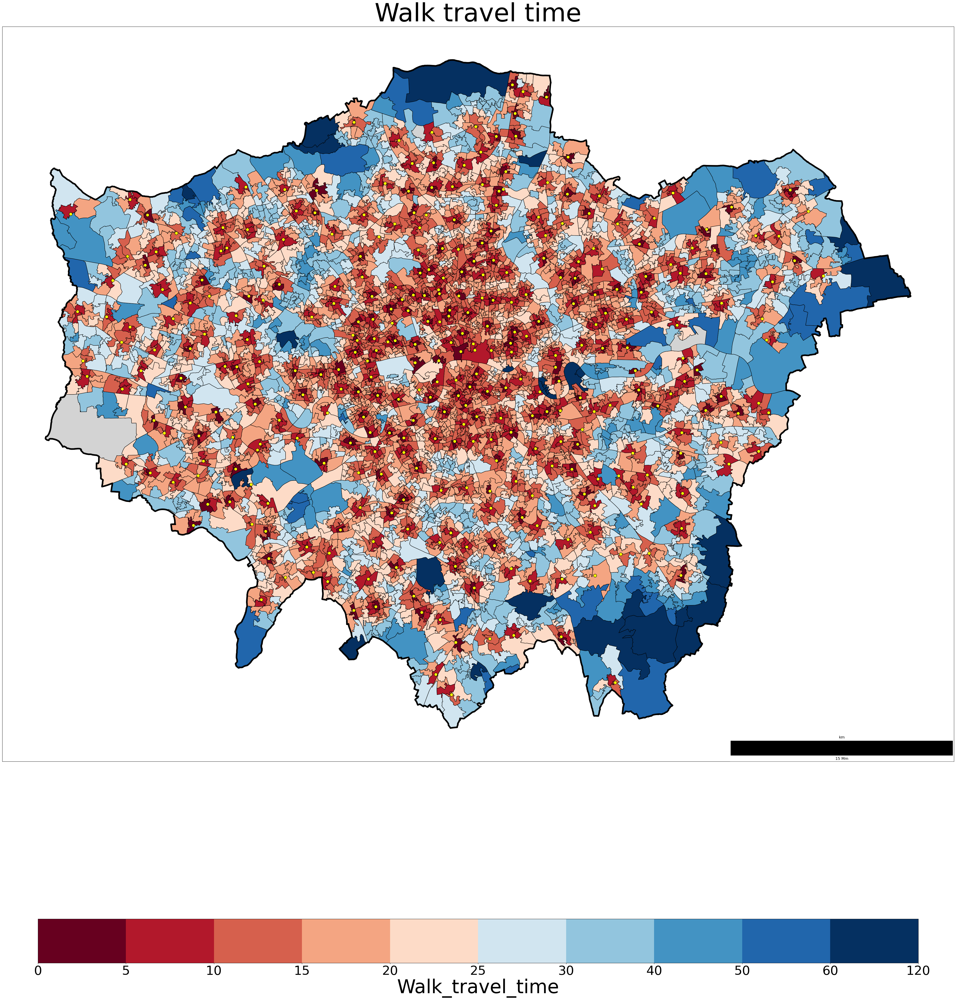

In [50]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

# Convert Final_df to a GeoDataFrame
Final_df_gpd = gpd.GeoDataFrame(Final_df, geometry='geometry')

# Custom list of colors and corresponding ranges
colors = ['#67001f', '#b2182b', '#d6604d', '#f4a582', '#fddbc7',
          # '#fbe3d4', '#f7f6f6',  
          '#d1e5f0', '#92c5de', '#4393c3', '#2166ac', '#053061']

# Custom intervals
bounds = [0, 5, 10, 15, 20, 25, 30, 40, 50, 60, 120]

# Create custom color map and norm
cmap = mcolors.ListedColormap(colors)
norm = mcolors.BoundaryNorm(bounds, cmap.N)

# Plot the map and color it based on the values in the Walk_travel_time column
fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # Adjust the size to a more screen-friendly ratio

# # Plot the London boundary map as the background
# London_LSOA_dropped.boundary.plot(ax=ax, color='black', linewidth=1)

# Plot the outermost boundary
outer_boundary = gpd.GeoSeries([London_LSOA_dropped.unary_union])
outer_boundary.boundary.plot(ax=ax, color='black', linewidth=5)  # Adjust linewidth to make it thicker

# Use the GeoDataFrame's plot function to draw the map
Final_df_gpd.plot(column='Walk_travel_time', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# Use the GeoDataFrame's plot function to draw the map, handling NaN values
Final_df_gpd.plot(
    column='Walk_travel_time',
    cmap=cmap,
    legend=False,
    norm=norm,
    ax=ax,
    edgecolor='black',
    missing_kwds={
        "color": "lightgrey",  # Set the color of areas with NaN values to grey
        "label": "No Data"
    }
)

# Overlay library location points with yellow fill and black outline
public_library_locations.plot(ax=ax, marker='o', color='yellow', edgecolor='black', markersize=100, label='Public Libraries')

# Manually create a colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', boundaries=bounds, ticks=bounds, shrink=0.5)
cbar.set_label('Walk_travel_time', fontsize=60)  # Set the font size of the colorbar label
cbar.ax.tick_params(labelsize=40)  # Set the font size of the colorbar tick labels

plt.title('Walk travel time', fontsize=80)

# Remove axis labels but keep the border
ax.set_xticks([])  # Remove x-axis labels
ax.set_yticks([])  # Remove y-axis labels

# Keep the border
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_visible(True)

# Add a scale bar, units in kilometers (km)
scalebar = ScaleBar(
    1,  # The actual length corresponding to each map unit (1 here means 1 map unit = 1 meter)
    units='km',  # Set units to kilometers
    location='lower right',  # Set the location to the lower right corner
    scale_loc='bottom',  # Position of the scale numbers (above or below)
    length_fraction=0.25,  # Fraction of the plot width that the scale bar occupies
    width_fraction=0.02,  # Width of the scale bar
    color='black',  # Color of the scale bar
    box_color='white',  # Background color of the scale bar
    box_alpha=0.8,  # Background transparency
    font_properties={'size': 12},  # Font size
    label='km'  # Label for the scale bar
)
ax.add_artist(scalebar)

# Save the image to the specified path
plt.savefig("Plot_final_0826/Walk_travel_time.png")

plt.show()

### 3.2.2 Transit

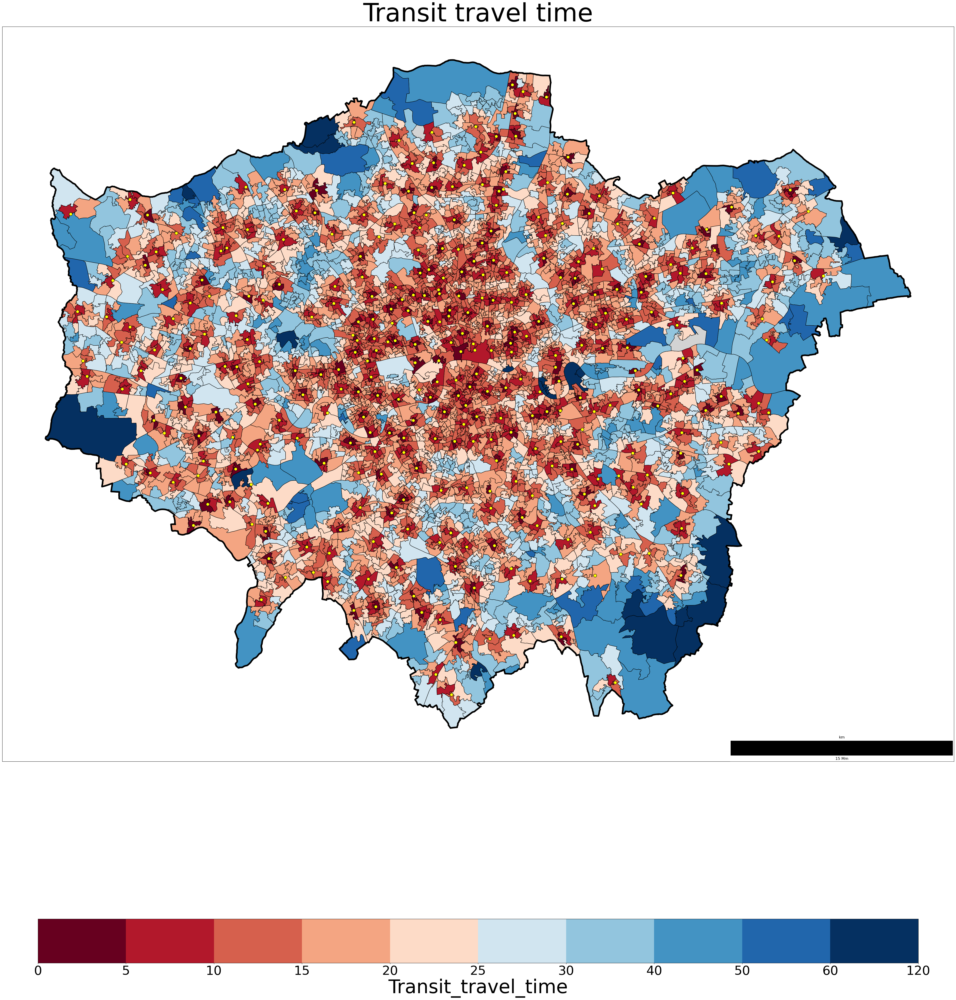

In [52]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

# Convert Final_df to a GeoDataFrame
Final_df_gpd = gpd.GeoDataFrame(Final_df, geometry='geometry')

# Custom list of colors and corresponding ranges
colors = ['#67001f', '#b2182b', '#d6604d', '#f4a582', '#fddbc7',
          # '#fbe3d4', '#f7f6f6',  
          '#d1e5f0', '#92c5de', '#4393c3', '#2166ac', '#053061']

# Custom intervals
bounds = [0, 5, 10, 15, 20, 25, 30, 40, 50, 60, 120]

# Create a custom color map and norm
cmap = mcolors.ListedColormap(colors)
norm = mcolors.BoundaryNorm(bounds, cmap.N)

# Plot the map and color it based on the values in the Transit_travel_time column
fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # Adjust the size to a more screen-friendly ratio

# # Plot the London boundary map as the background
# London_LSOA_dropped.boundary.plot(ax=ax, color='black', linewidth=1)

# Plot the outermost boundary
outer_boundary = gpd.GeoSeries([London_LSOA_dropped.unary_union])
outer_boundary.boundary.plot(ax=ax, color='black', linewidth=5)  # Adjust linewidth to make it thicker

# Use the GeoDataFrame's plot function to draw the map
Final_df_gpd.plot(column='Transit_travel_time', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# Use the GeoDataFrame's plot function to draw the map, handling NaN values
Final_df_gpd.plot(
    column='Transit_travel_time',
    cmap=cmap,
    legend=False,
    norm=norm,
    ax=ax,
    edgecolor='black',
    missing_kwds={
        "color": "lightgrey",  # Set the color of areas with NaN values to grey
        "label": "No Data"
    }
)

# Overlay library location points with yellow fill and black outline
public_library_locations.plot(ax=ax, marker='o', color='yellow', edgecolor='black', markersize=100, label='Public Libraries')

# Manually create a colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', boundaries=bounds, ticks=bounds, shrink=0.5)
cbar.set_label('Transit_travel_time', fontsize=60)  # Set the font size of the colorbar label
cbar.ax.tick_params(labelsize=40)  # Set the font size of the colorbar tick labels

plt.title('Transit travel time', fontsize=80)

# Remove axis labels but keep the border
ax.set_xticks([])  # Remove x-axis labels
ax.set_yticks([])  # Remove y-axis labels

# Keep the border
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_visible(True)

# Add a scale bar, units in kilometers (km)
scalebar = ScaleBar(
    1,  # The actual length corresponding to each map unit (1 here means 1 map unit = 1 meter)
    units='km',  # Set units to kilometers
    location='lower right',  # Set the location to the lower right corner
    scale_loc='bottom',  # Position of the scale numbers (above or below)
    length_fraction=0.25,  # Fraction of the plot width that the scale bar occupies
    width_fraction=0.02,  # Width of the scale bar
    color='black',  # Color of the scale bar
    box_color='white',  # Background color of the scale bar
    box_alpha=0.8,  # Background transparency
    font_properties={'size': 12},  # Font size
    label='km'  # Label for the scale bar
)
ax.add_artist(scalebar)

# Save the image to the specified path
plt.savefig("Plot_final_0826/Transit_travel_time.png")

plt.show()

### 3.2.3 Car

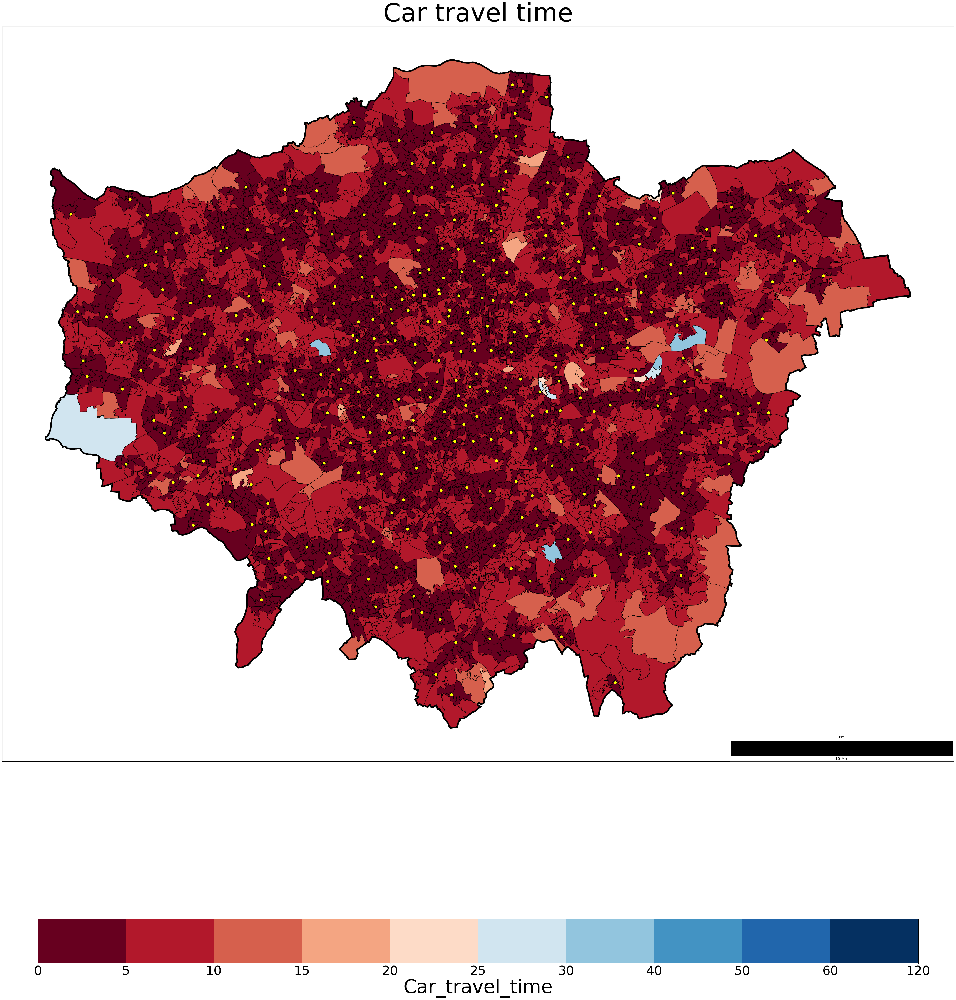

In [54]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

# Convert Final_df to a GeoDataFrame
Final_df_gpd = gpd.GeoDataFrame(Final_df, geometry='geometry')

# Custom list of colors and corresponding ranges
colors = ['#67001f', '#b2182b', '#d6604d', '#f4a582', '#fddbc7',
          # '#fbe3d4', '#f7f6f6',  
          '#d1e5f0', '#92c5de', '#4393c3', '#2166ac', '#053061']

# Custom intervals
bounds = [0, 5, 10, 15, 20, 25, 30, 40, 50, 60, 120]

# Create a custom color map and norm
cmap = mcolors.ListedColormap(colors)
norm = mcolors.BoundaryNorm(bounds, cmap.N)

# Plot the map and color it based on the values in the Car_travel_time column
fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # Adjust the size to a more screen-friendly ratio

# # Plot the London boundary map as the background
# London_LSOA_dropped.boundary.plot(ax=ax, color='black', linewidth=1)

# Plot the outermost boundary
outer_boundary = gpd.GeoSeries([London_LSOA_dropped.unary_union])
outer_boundary.boundary.plot(ax=ax, color='black', linewidth=5)  # Adjust linewidth to make it thicker

# Use the GeoDataFrame's plot function to draw the map
Final_df_gpd.plot(column='Car_travel_time', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# Use the GeoDataFrame's plot function to draw the map, handling NaN values
Final_df_gpd.plot(
    column='Car_travel_time',
    cmap=cmap,
    legend=False,
    norm=norm,
    ax=ax,
    edgecolor='black',
    missing_kwds={
        "color": "lightgrey",  # Set the color of areas with NaN values to grey
        "label": "No Data"
    }
)

# Overlay library location points with yellow fill and black outline
public_library_locations.plot(ax=ax, marker='o', color='yellow', edgecolor='black', markersize=100, label='Public Libraries')

# Manually create a colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', boundaries=bounds, ticks=bounds, shrink=0.5)
cbar.set_label('Car_travel_time', fontsize=60)  # Set the font size of the colorbar label
cbar.ax.tick_params(labelsize=40)  # Set the font size of the colorbar tick labels

plt.title('Car travel time', fontsize=80)

# Remove axis labels but keep the border
ax.set_xticks([])  # Remove x-axis labels
ax.set_yticks([])  # Remove y-axis labels

# Keep the border
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_visible(True)

# Add a scale bar, units in kilometers (km)
scalebar = ScaleBar(
    1,  # The actual length corresponding to each map unit (1 here means 1 map unit = 1 meter)
    units='km',  # Set units to kilometers
    location='lower right',  # Set the location to the lower right corner
    scale_loc='bottom',  # Position of the scale numbers (above or below)
    length_fraction=0.25,  # Fraction of the plot width that the scale bar occupies
    width_fraction=0.02,  # Width of the scale bar
    color='black',  # Color of the scale bar
    box_color='white',  # Background color of the scale bar
    box_alpha=0.8,  # Background transparency
    font_properties={'size': 12},  # Font size
    label='km'  # Label for the scale bar
)
ax.add_artist(scalebar)

# Save the image to the specified path
plt.savefig("Plot_final_0826/Car_travel_time.png")

plt.show()

### 3.2.4 Bicycle

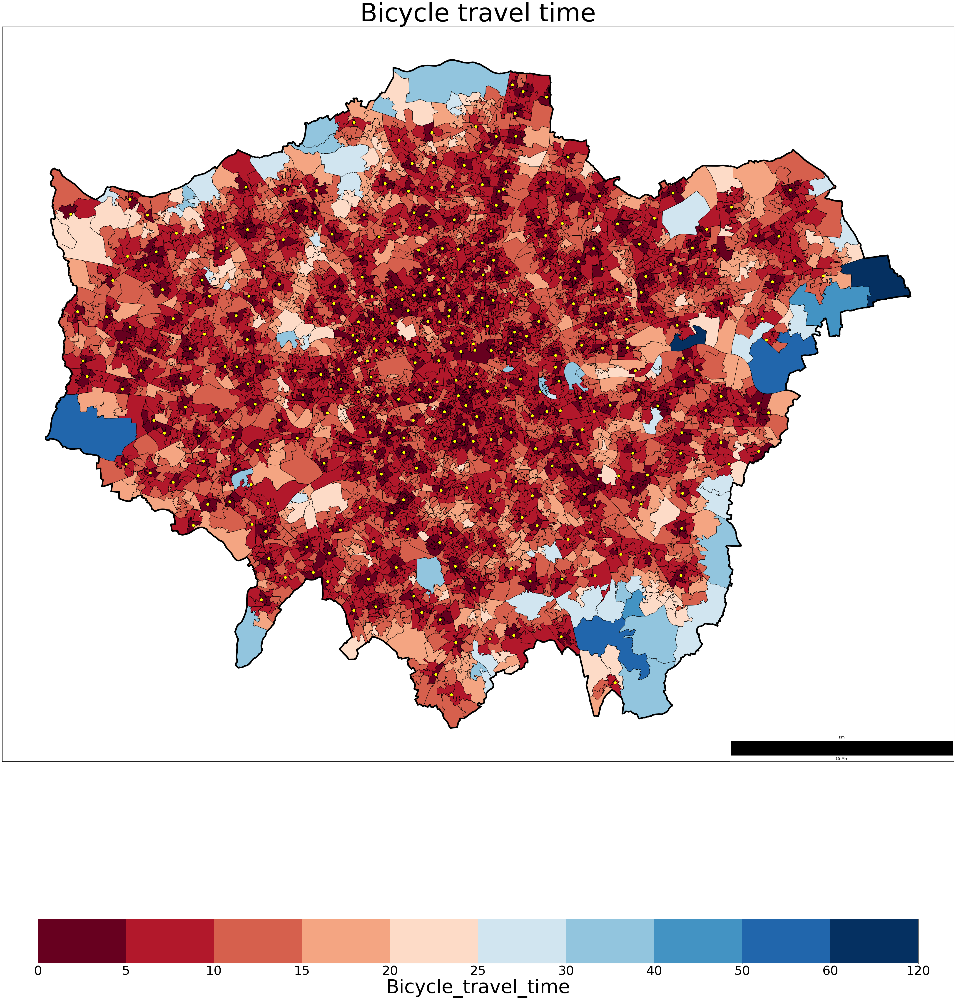

In [56]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import numpy as np

# Convert Final_df to a GeoDataFrame
Final_df_gpd = gpd.GeoDataFrame(Final_df, geometry='geometry')

# Custom list of colors and corresponding ranges
colors = ['#67001f', '#b2182b', '#d6604d', '#f4a582', '#fddbc7',
          # '#fbe3d4', '#f7f6f6',  
          '#d1e5f0', '#92c5de', '#4393c3', '#2166ac', '#053061']

# Custom intervals
bounds = [0, 5, 10, 15, 20, 25, 30, 40, 50, 60, 120]

# Create a custom color map and norm
cmap = mcolors.ListedColormap(colors)
norm = mcolors.BoundaryNorm(bounds, cmap.N)

# Plot the map and color it based on the values in the Bicycle_travel_time column
fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # Adjust the size to a more screen-friendly ratio

# # Plot the London boundary map as the background
# London_LSOA_dropped.boundary.plot(ax=ax, color='black', linewidth=1)

# Plot the outermost boundary
outer_boundary = gpd.GeoSeries([London_LSOA_dropped.unary_union])
outer_boundary.boundary.plot(ax=ax, color='black', linewidth=5)  # Adjust linewidth to make it thicker

# Use the GeoDataFrame's plot function to draw the map
Final_df_gpd.plot(column='Bicycle_travel_time', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# Use the GeoDataFrame's plot function to draw the map, handling NaN values
Final_df_gpd.plot(
    column='Bicycle_travel_time',
    cmap=cmap,
    legend=False,
    norm=norm,
    ax=ax,
    edgecolor='black',
    missing_kwds={
        "color": "lightgrey",  # Set the color of areas with NaN values to grey
        "label": "No Data"
    }
)

# Overlay library location points with yellow fill and black outline
public_library_locations.plot(ax=ax, marker='o', color='yellow', edgecolor='black', markersize=100, label='Public Libraries')

# Manually create a colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax, orientation='horizontal', boundaries=bounds, ticks=bounds, shrink=0.5)
cbar.set_label('Bicycle_travel_time', fontsize=60)  # Set the font size of the colorbar label
cbar.ax.tick_params(labelsize=40)  # Set the font size of the colorbar tick labels

plt.title('Bicycle travel time', fontsize=80)

# Remove axis labels but keep the border
ax.set_xticks([])  # Remove x-axis labels
ax.set_yticks([])  # Remove y-axis labels

# Keep the border
ax.spines['top'].set_visible(True)
ax.spines['right'].set_visible(True)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_visible(True)

# Add a scale bar, units in kilometers (km)
scalebar = ScaleBar(
    1,  # The actual length corresponding to each map unit (1 here means 1 map unit = 1 meter)
    units='km',  # Set units to kilometers
    location='lower right',  # Set the location to the lower right corner
    scale_loc='bottom',  # Position of the scale numbers (above or below)
    length_fraction=0.25,  # Fraction of the plot width that the scale bar occupies
    width_fraction=0.02,  # Width of the scale bar
    color='black',  # Color of the scale bar
    box_color='white',  # Background color of the scale bar
    box_alpha=0.8,  # Background transparency
    font_properties={'size': 12},  # Font size
    label='km'  # Label for the scale bar
)
ax.add_artist(scalebar)

# Save the image to the specified path
plt.savefig("Plot_final_0826/Bicycle_travel_time.png")

plt.show()